# PSF Mangling

Radially average our PSFs into OTFs to try Lin's algorithm on.

For Lin's code we need to truncate the number of directions.

my code needs some more work to rough out the edges.

In [1]:
'BEST' PSF data found here: 
    
    Y:\Cryo_data\ORCA_Data\20190918_(Beads and OTFs)\Test OTFs\488 OTF Bead 8_20190919_141256
        
        
BAD PSF:

'Y:\Cryo_data\ORCA_Data\20190920_(New Beads and OTFs)\Test OTFs\Bad\488 OTF Bead 6_20190923_105004'

SyntaxError: invalid syntax (886605790.py, line 1)

In [1]:
%pylab inline
import mrc
# from skimage.external import tifffile as tif
import tqdm
import os
import glob
# %load_ext autoreload
# %autoreload 2
# from simrecon_utils import PSF3DProcessor, remove_bg, center_data
# # from pyDecon.decon import richardson_lucy
import re
from dphplotting import display_grid, recolor, make_grid, clean_grid
from shutil import copyfile
import seaborn as sns

%pylab is deprecated, use %matplotlib inline and import the required libraries.
Populating the interactive namespace from numpy and matplotlib


In [2]:
home = r'Y:\Cryo_data2\ORCA_data\20240430 - LID 740 etc\AR Cells\beads\AR-coated bead 1c 0.3W 25ms no 532 on_20240508_112619'

In [3]:
re_nm = re.compile("\d+(?= nm)")
print(re_nm)

re.compile('\\d+(?= nm)')


In [4]:
!C:/SIMrecon_svn/radialft -h

Usage:
radialft [[input file] [output file]] [Options]

Options:
	-beaddiam F -- the diameter of the bead in microns (default is 0.12)
	-angle F -- the k0 vector angle with which the PSF is taken (default is 0)
	-ls x -- the illumination pattern's line spacing (in microns, default is 0.2)
	-nocompen -- do not perform bead size compensation (default is to perform)
	-5bands -- to output 5 OTF bands (default is combining higher-order's real and imag bands into one output
	-fixorigin kr1 kr2 -- the starting and end pixel for interpolation along kr axis (default is 2 and 9)
	-na x -- the (effective) NA of the objective
	-nimm x -- the index of refraction of the immersion liquid
	-leavekz kz1_1 kz1_2 kz2 -- the pixels to be retained on kz axis
	-I2M I2m_otf_file_name -- data contains I2M PSF and supply the I2M otf file name
	-background bkgd_value -- use the supplied number as the background to subtract
	-help or -h -- print this message


In [5]:
import os


def process_otf(path, ks=None):
    
    wl = re_nm.findall(tail)[0]
    print(wl)
    print(path)
    wl_um = int(wl) / 1000
    path2 = '{}nmLinOTF{}.mrc'.format(wl, i)
    
    if ks is None:
        extra = ''
    else:
        extra = '-leavekz {} {} {}'.format(*ks)
        
    msg = !{os.path.splitdrive(head)[0]} & cd & cd {head} & cd & C:/SIMrecon_svn/radialft {'"' + tail + '"'} {'"' + path2 + '"'} -angle 0.203\
    -ls {wl_um/2/0.81} -beaddiam 0.2 -na 0.82 -nimm 1.0 -fixorigin 3 5 -ifixkr 16 -background 130 {extra}

    print(head)
    OTF_Folder = r'computed_OTF_folder'
    print(OTF_Folder)
    OTF_path = os.path.join(home,OTF_Folder)
    print(OTF_path)
    OTF_Path_file = os.path.join(OTF_path,path2)
    print(OTF_Path_file)
    OTF_file = os.path.join(head, path2)
    print(OTF_file)
    
    if not os.path.exists(OTF_path):
        print("Creating Folder for You.")
        os.makedirs(OTF_path)
    
    copyfile(os.path.join(head, path2), OTF_Path_file)
    os.remove(os.path.join(head, path2))
    return OTF_Path_file

cropped_MRC
Y:\Cryo_data2\ORCA_data\20240430 - LID 740 etc\AR Cells\beads\AR-coated bead 1c 0.3W 25ms no 532 on_20240508_112619\cropped_MRC
Y:\Cryo_data2\ORCA_data\20240430 - LID 740 etc\AR Cells\beads\AR-coated bead 1c 0.3W 25ms no 532 on_20240508_112619\cropped_MRC\488 nm 5 phases 0.81 NA Single Orientation Linear SIM_cam1_0_crop.mrc
Y:488 nm 5 phases 0.81 NA Single Orientation Linear SIM_cam1_0_crop.mrc
Creating Folder for You.
Y:\Cryo_data2\ORCA_data\20240430 - LID 740 etc\AR Cells\beads\AR-coated bead 1c 0.3W 25ms no 532 on_20240508_112619\488 nm 5 phases 0.81 NA Single Orientation Linear SIM_cam1_0.mrc
(325, 256, 256)


C:\Users\Cryo SIM-PALM\AppData\Local\Temp\ipykernel_22176\2750593996.py:34: RuntimeWarning: divide by zero encountered in log
  for ax, otf_data in zip(axs[1], log(mag)):


(325, 160, 160)


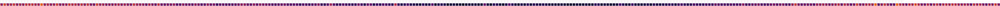

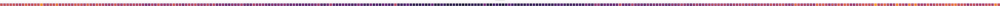

In [6]:
# Crop wrong sized PSF:


for path in sorted(glob.iglob(home + "/*_0*.mrc", recursive=True)):
    
    path2 = r'488 nm 5 phases 0.81 NA Single Orientation Linear SIM_cam1_0_crop.mrc'
    head = os.path.splitdrive(path)[0]
    
    crop_Folder = r'cropped_MRC'
    print(crop_Folder)
    crop_path = os.path.join(home,crop_Folder)
    print(crop_path)
    crop_Path_file = os.path.join(crop_path,path2)
    print(crop_Path_file)
    crop_file = os.path.join(head, path2)
    print(crop_file)
    
    if not os.path.exists(crop_path):
        print("Creating Folder for You.")
        os.makedirs(crop_path)
    
    path = path
    print(path)
    mymrc = mrc.Mrc(path)
    otf = array(mymrc.data)
    nz, ny, nx = otf.shape
    print(otf.shape)
    mag = abs(otf)
    mask = mag > 0
    fig, axs = make_grid(nz * 2, 2, figsize=2, grid_aspect=ny / nx)
    for ax, otf_data in zip(axs[0], angle(otf) * mask):
        ax.matshow(otf_data, cmap="seismic", vmin=-pi, vmax=pi)

    for ax, otf_data in zip(axs[1], log(mag)):
        ax.matshow(otf_data, cmap="inferno")

    for ax in axs.ravel():
        ax.grid("off")
        ax.set_xticks([])
        ax.set_yticks([])
        ax.patch.set_visible(False)
        for s in ax.spines.values():
            s.set_visible(True)
            s.set_color("k")
    
    # USER INPUT ! ! ! ! 
    rectangle_x_left_co_ordinate = 52  # USER Input this value using FIJI rectangle specify to set X value
    rectangle_Y_TOP_co_ordinate = 89   # USER Input this value using FIJI rectangle specify to set Y value
    
    rectangle_Y_TOP_co_ordinate = 95 -  rectangle_Y_TOP_co_ordinate  # PYTHON ROI OFFSET, DON'T EDIT!
     
    
    width = rectangle_x_left_co_ordinate  + 160
    height = rectangle_Y_TOP_co_ordinate + 160
    otf = array(mymrc.data)[:,rectangle_Y_TOP_co_ordinate:height,rectangle_x_left_co_ordinate:width]
    nz, ny, nx = otf.shape
    print(otf.shape)
    mag = abs(otf)
    mask = mag > 0
    fig, axs = make_grid(nz * 2, 2, figsize=2, grid_aspect=ny / nx)
    for ax, otf_data in zip(axs[0], angle(otf) * mask):
        ax.matshow(otf_data, cmap="seismic", vmin=-pi, vmax=pi)

    for ax, otf_data in zip(axs[1], log(mag)):
        ax.matshow(otf_data, cmap="inferno")

    for ax in axs.ravel():
        ax.grid("off")
        ax.set_xticks([])
        ax.set_yticks([])
        ax.patch.set_visible(False)
        for s in ax.spines.values():
            s.set_visible(True)
            s.set_color("k")
    
    fig.suptitle(os.path.split(path)[-1], y=1.01, fontweight="bold")
    fig.tight_layout()
    
    crop_save = os.path.join(crop_path, r'488 nm 5 phases 0.81 NA Single Orientation Linear SIM_cam1_0_crop.mrc')
    mrc.save(otf, crop_save, hdr=mymrc.hdr,ifExists='overwrite')
    #mymrc.close()
    del mymrc

In [77]:
for i, path in enumerate(tqdm.tqdm_notebook(sorted(glob.iglob(home + r"/cropped_MRC/*_crop*.mrc")))):
    print(path)

C:\Users\Cryo SIM-PALM\AppData\Local\Temp\ipykernel_34424\1318626502.py:1: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for i, path in enumerate(tqdm.tqdm_notebook(sorted(glob.iglob(home + r"/cropped_MRC/*_crop*.mrc")))):


0it [00:00, ?it/s]

In [7]:
for i, path in enumerate(tqdm.tqdm_notebook(sorted(glob.iglob(home + r"/cropped_MRC/*_crop*.mrc")))):
    
    head, tail = os.path.split(os.path.abspath(path))
    print(head)
    print(tail)
#     if os.path.exists(head + ".mrc"):
#         continue
    process_otf(path)

C:\Users\Cryo SIM-PALM\AppData\Local\Temp\ipykernel_22176\3687132524.py:1: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for i, path in enumerate(tqdm.tqdm_notebook(sorted(glob.iglob(home + r"/cropped_MRC/*_crop*.mrc")))):


  0%|          | 0/1 [00:00<?, ?it/s]

Y:\Cryo_data2\ORCA_data\20240430 - LID 740 etc\AR Cells\beads\AR-coated bead 1c 0.3W 25ms no 532 on_20240508_112619\cropped_MRC
488 nm 5 phases 0.81 NA Single Orientation Linear SIM_cam1_0_crop.mrc
488
Y:\Cryo_data2\ORCA_data\20240430 - LID 740 etc\AR Cells\beads\AR-coated bead 1c 0.3W 25ms no 532 on_20240508_112619/cropped_MRC\488 nm 5 phases 0.81 NA Single Orientation Linear SIM_cam1_0_crop.mrc
Y:\Cryo_data2\ORCA_data\20240430 - LID 740 etc\AR Cells\beads\AR-coated bead 1c 0.3W 25ms no 532 on_20240508_112619\cropped_MRC
computed_OTF_folder
Y:\Cryo_data2\ORCA_data\20240430 - LID 740 etc\AR Cells\beads\AR-coated bead 1c 0.3W 25ms no 532 on_20240508_112619\computed_OTF_folder
Y:\Cryo_data2\ORCA_data\20240430 - LID 740 etc\AR Cells\beads\AR-coated bead 1c 0.3W 25ms no 532 on_20240508_112619\computed_OTF_folder\488nmLinOTF0.mrc
Y:\Cryo_data2\ORCA_data\20240430 - LID 740 etc\AR Cells\beads\AR-coated bead 1c 0.3W 25ms no 532 on_20240508_112619\cropped_MRC\488nmLinOTF0.mrc
Creating Folder fo

In [8]:
sns.set_style("white")
sns.set_context("notebook")

In [9]:
def display_otf(path):
    mymrc = mrc.Mrc(path)
    otf = array(mymrc.data)
    nz, ny, nx = otf.shape
    mag = abs(otf)
    mask = mag > 0
    fig, axs = make_grid(nz * 2, 2, figsize=2, grid_aspect=ny / nx)
    for ax, otf_data in zip(axs[0], angle(otf) * mask):
        ax.matshow(otf_data, cmap="seismic", vmin=-pi, vmax=pi)

    for ax, otf_data in zip(axs[1], log(mag)):
        ax.matshow(otf_data, cmap="inferno")

    for ax in axs.ravel():
        ax.grid("off")
        ax.set_xticks([])
        ax.set_yticks([])
        ax.patch.set_visible(False)
        for s in ax.spines.values():
            s.set_visible(True)
            s.set_color("k")
    
    fig.suptitle(os.path.split(path)[-1], y=1.01, fontweight="bold")
    fig.tight_layout()

    #mymrc.close()
    del mymrc
    

Y:\Cryo_data2\ORCA_data\20240430 - LID 740 etc\AR Cells\beads\AR-coated bead 1c 0.3W 25ms no 532 on_20240508_112619\computed_OTF_folder\488nmLinOTF0.mrc


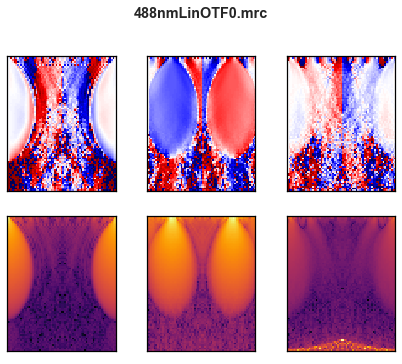

In [10]:
for path in sorted(glob.iglob(os.path.join(home, r'computed_OTF_folder') + "/*.mrc", recursive=True)):
    print(path)
    display_otf(path)

C:\Users\Cryo SIM-PALM\AppData\Local\Temp\ipykernel_34424\2194668110.py:1: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for i, path in enumerate(tqdm.tqdm_notebook(sorted(glob.iglob(home + "/cropped_MRC/*_crop*.mrc")))):


  0%|          | 0/1 [00:00<?, ?it/s]

Y:\Cryo_data2\ORCA_data\20240430 - LID 740 etc\cells\no1 PSF no2 1.2W 25ms retake_20240503_170242/cropped_MRC\488 nm 5 phases 0.81 NA Single Orientation Linear SIM_cam1_0_crop.mrc
488
Y:\Cryo_data2\ORCA_data\20240430 - LID 740 etc\cells\no1 PSF no2 1.2W 25ms retake_20240503_170242/cropped_MRC\488 nm 5 phases 0.81 NA Single Orientation Linear SIM_cam1_0_crop.mrc
Y:\Cryo_data2\ORCA_data\20240430 - LID 740 etc\cells\no1 PSF no2 1.2W 25ms retake_20240503_170242\cropped_MRC
computed_OTF_folder
Y:\Cryo_data2\ORCA_data\20240430 - LID 740 etc\cells\no1 PSF no2 1.2W 25ms retake_20240503_170242\computed_OTF_folder
Y:\Cryo_data2\ORCA_data\20240430 - LID 740 etc\cells\no1 PSF no2 1.2W 25ms retake_20240503_170242\computed_OTF_folder\488nmLinOTF0.mrc
Y:\Cryo_data2\ORCA_data\20240430 - LID 740 etc\cells\no1 PSF no2 1.2W 25ms retake_20240503_170242\cropped_MRC\488nmLinOTF0.mrc


C:\Users\Cryo SIM-PALM\AppData\Local\Temp\ipykernel_34424\927484621.py:11: RuntimeWarning: divide by zero encountered in log
  for ax, otf_data in zip(axs[1], log(mag)):


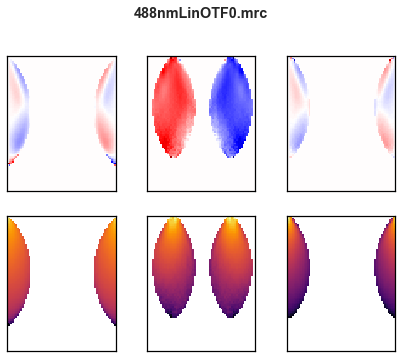

In [69]:

for i, path in enumerate(tqdm.tqdm_notebook(sorted(glob.iglob(home + "/cropped_MRC/*_crop*.mrc")))):
    
    print(path)
#    
    display_otf(process_otf(path, (14, 16, 2)))

In [19]:


#display_otf(process_otf(path, (14, 16, 2)))

F:ORCA_Data/20190920_(New Beads and OTFs)/Test OTFs/532 OTF Bead 3_20190920_154920/532 nm 5 phases 0.81 NA Single Orientation Linear SIM_cam1_0.mrc


C:\Users\Dan\Miniconda3\envs\sandbox\lib\site-packages\ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log
  # This is added back by InteractiveShellApp.init_path()


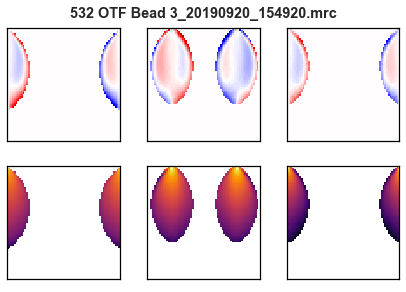

In [51]:

path = otf_home + '532 OTF Bead 3_20190920_154920/532 nm 5 phases 0.81 NA Single Orientation Linear SIM_cam1_0.mrc'
head, tail = os.path.split(os.path.abspath(path))
print(path)
display_otf(process_otf(path, (12, 15, 2)))

F:ORCA_Data/20190920_(New Beads and OTFs)/Test OTFs/561 OTF Bead 3_20190920_154442/560 nm 5 phases 0.81 NA Single Orientation Linear SIM_cam1_0.mrc


C:\Users\Dan\Miniconda3\envs\sandbox\lib\site-packages\ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log
  # This is added back by InteractiveShellApp.init_path()


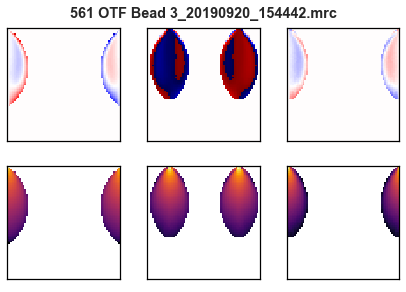

In [62]:
path = otf_home + '561 OTF Bead 3_20190920_154442/560 nm 5 phases 0.81 NA Single Orientation Linear SIM_cam1_0.mrc'
head, tail = os.path.split(os.path.abspath(path))
print(path)
display_otf(process_otf(path, (11, 13, 2)))

F:ORCA_Data/20190920_(New Beads and OTFs)/Test OTFs/642 OTF Bead 2_20190920_160621/642 nm 5 phases 0.81 NA Single Orientation Linear SIM_cam1_0.mrc


C:\Users\Dan\Miniconda3\envs\sandbox\lib\site-packages\ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log
  # This is added back by InteractiveShellApp.init_path()


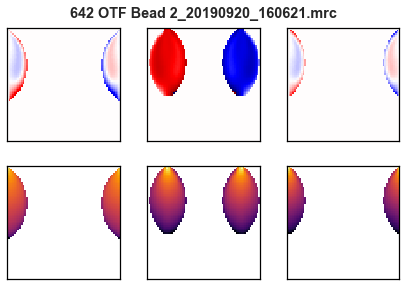

In [63]:
path = otf_home + '642 OTF Bead 2_20190920_160621/642 nm 5 phases 0.81 NA Single Orientation Linear SIM_cam1_0.mrc'
head, tail = os.path.split(os.path.abspath(path))
print(path)
display_otf(process_otf(path, (10, 12, 1)))

---
# Junk

from peaks.utils import gauss_fit

from peaks.stackanalysis import PSFStackAnalyzer
def fit_peak(data):
    psf = PSFStackAnalyzer(np.array(data), 1.5)
    psf.peakfinder.find_blobs()
    psf.fitPeaks(16)
    psf.calc_psf_params(withoffset=False)
    return psf.fits[0], psf.psf_params.loc[0]

x = np.arange(32) * 0.25 - 4
popts1 = []
# popts2 = []
fig, ax = subplots(1,1, figsize=(4,4))
for path2 in os.listdir(home):
    path = os.path.abspath(home + path2)
    if os.path.isdir(path) and "PSF4" in path:
        try:
            SIM_OTF = Mrc.Mrc(glob.glob(path + "/*SIM*.mrc")[0]).data
            SIM_OTF_WF = SIM_OTF.reshape((-1, 1, 5,) + SIM_OTF.shape[-2:]).mean((1,2))
        except IndexError:
            pass
        else:
#             WF_OTF = Mrc.Mrc(glob.glob(path + "/*WF*.mrc")[0]).data
            SIM_OTF_WF_fit, SIM_OTF_WF_params = fit_peak(SIM_OTF_WF)
            plot(x, SIM_OTF_WF_fit.amp)
#             WF_OTF_fit, WF_OTF_params = fit_peak(WF_OTF)
#             plot(x, WF_OTF_fit.amp / WF_OTF_fit.amp.max())
            ax.set_title(path2)
            popts1.append(SIM_OTF_WF_params)
#             popts2.append(WF_OTF_params)

import pandas as pd

plot(np.arange(17) * 0.25 + 18, pd.DataFrame(popts1).amp.values)

plot((pd.DataFrame(popts1).z0.values - 33) * 250)
plot((pd.DataFrame(popts2).z0.values - 33) * 250)

("Amplitude unphysical, amp = {:.3f}, data range = "
                           "{:.3f}").format(1, 2)

plot(xdata, np.array(popts1)[:17, 1])
plot(xdata, np.array(popts2)[:17, 1])

plot(xdata, (np.array(popts1)[:17, 1] - np.array(popts2)[:17, 1]) / np.array(popts1)[:17, 1], "-o")